Let's now also figure out how this annotation works in linking and stuff. Problem: In Allmethods it found too many nunique particles, but didn't seem to annotate them all. Which is weird.

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation
from matplotlib.animation import FuncAnimation
import time

from Particledrop import Landing_Flashes

import trackpy

In [4]:
def execute_amovie(moviedata):
    plt.rcParams["animation.html"] = "jshtml"
    plt.rcParams['figure.dpi'] = 100  
    plt.ioff()
    
    fig = plt.figure()
    axis = plt.axes()
    
    film = plt.imshow(moviedata[0])
    
    def init(): 
        film.set_data(moviedata[0])
        return [film]
    
    def animate(i):
        film.set_array(moviedata[i])
        return [film]
    
    anim = FuncAnimation(fig, animate, frames = moviedata.shape[0], init_func = init, interval = 200, blit = True)

    return anim

Number of particles simulated: 50


(array([6., 4., 2., 2., 5., 8., 6., 5., 8., 4.]),
 array([18.0989095 , 18.48876372, 18.87861793, 19.26847215, 19.65832636,
        20.04818058, 20.4380348 , 20.82788901, 21.21774323, 21.60759744,
        21.99745166]),
 <a list of 10 Patch objects>)

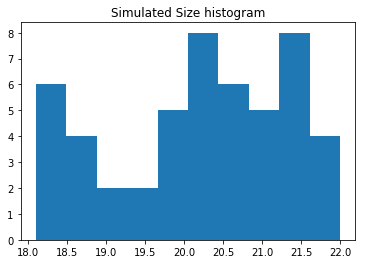

In [5]:
nf = 80
fov=[200,300]
meas = Landing_Flashes(fov=fov, seed=5045, numpar = 50, noise = 0, nframes = nf, signal = 20, sizevar=0.2, dark = 5, psize = 4, unevenIllumination = False)
testframe = nf-1
meas.noise = 1
plis = meas.parlist
movie= meas.genStack()
print('Number of particles simulated:', np.shape(plis)[0])

plt.figure()
plt.title('Simulated Size histogram')
plt.hist(plis[:,2])

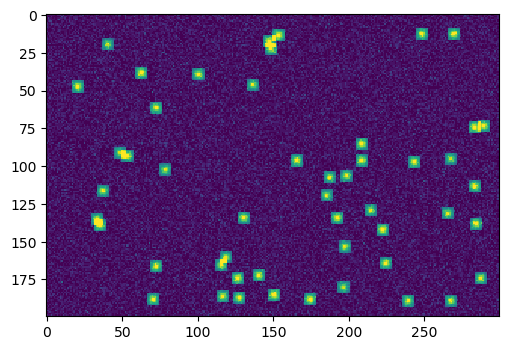

In [6]:
execute_amovie(movie)

Frame 79: 44 trajectories present.
Unique particles found: 50


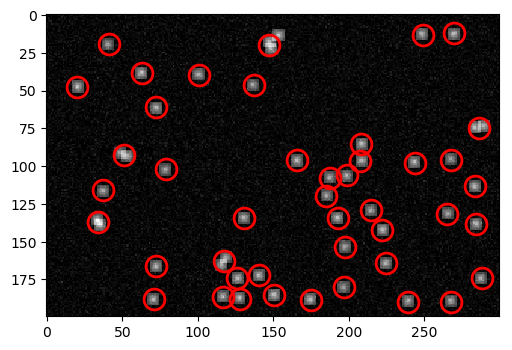

In [7]:
nf = movie.shape[0]
f = trackpy.batch(movie[:,:,:], 7, minmass=10, invert=False, processes='auto')
t = trackpy.link(f, 5, memory=5)
print('Unique particles found:', + t['particle'].nunique())
plt.figure()
trackpy.annotate(t[t['frame'] == nf-1], movie[nf-1]);

How did it find 50 unique particles? It annotates 44 trajectories....


Number of particles simulated: 50


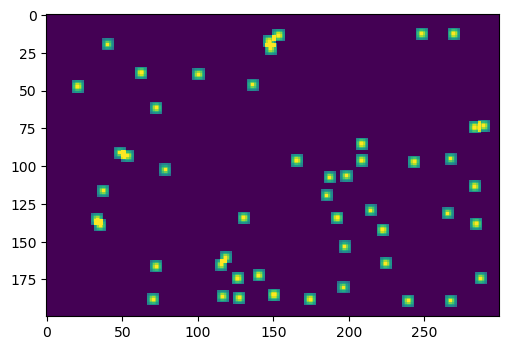

In [8]:
meas.noise = 0
plis0 = meas.parlist
movie0 = meas.genStack()
print('Number of particles simulated:', np.shape(plis0)[0])
execute_amovie(movie0)

Frame 79: 45 trajectories present.
Unique particles found: 45


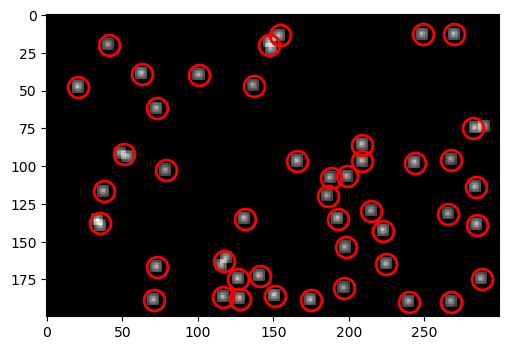

In [9]:
nf = movie0.shape[0]
f0 = trackpy.batch(movie0[:,:,:], 7, minmass=10, invert=False, processes='auto')
t0 = trackpy.link(f0, 5, memory=5)
print('Unique particles found:', + t0['particle'].nunique())
plt.figure()
trackpy.annotate(t0[t0['frame'] == nf-1], movie0[nf-1]);

Number of particles simulated: 50


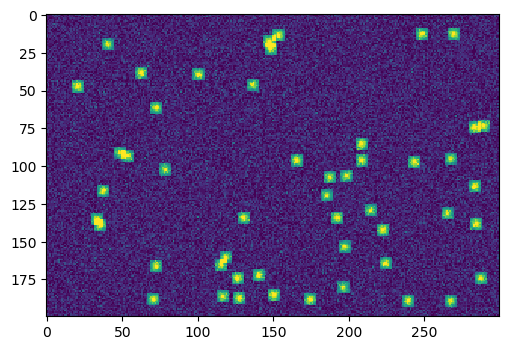

In [10]:
meas.noise = 2
plis1 = meas.parlist
movie1 = meas.genStack()
print('Number of particles simulated:', np.shape(plis1)[0])
execute_amovie(movie1)

Frame 79: 49 trajectories present.
Unique particles found before: 541
Unique particles found after: 67
Unique particles found after 2: 46


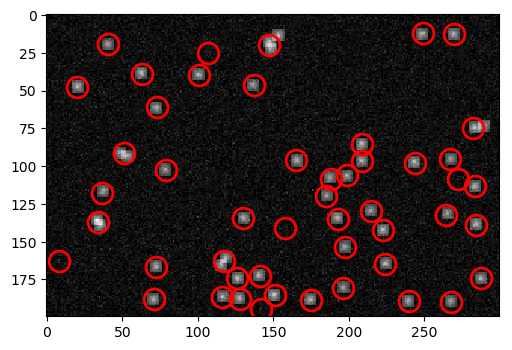

In [17]:
nf = movie1.shape[0]
f1 = trackpy.batch(movie1[:,:,:], 7, minmass=10, invert=False, processes='auto')
t1 = trackpy.link(f1, search_range = 5, memory=5)
tf1 = trackpy.filter_stubs(t1, 2)
tf2 = trackpy.filter_stubs(t1,3)
print('Unique particles found before:', + t1['particle'].nunique())
print('Unique particles found after:', + tf1['particle'].nunique())
print('Unique particles found after 2:', + tf2['particle'].nunique())
plt.figure()
trackpy.annotate(t1[t1['frame'] == nf-1], movie1[nf-1]);

Ah, het is volledig naar de getver nu: 541 Unique particles, 49 geannoteerd. Dat is interessant. Filter_stubs kan het een beetje oplossen, maar het blijft raar dat er andere cirkeltjes gezet worden. Kevin gebruikt weer een andere linking:


In [19]:
nf = movie1.shape[0]
f1 = trackpy.batch(movie1[:,:,:], 7, minmass=10, invert=False, processes='auto')
t = trackpy.link_df(f1[f1['mass']==f1['mass']], 3, memory=1)
print('Unique particles found before:', + t['particle'].nunique())

Frame 79: 49 trajectories present.
Unique particles found before: 578
